In [10]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

%config Completer.use_jedi = False

/kaggle/input/medical-insurance/insurance.csv
/kaggle/input/medical-insurance/documentation.txt


# Importing Libraries and Dataset

In [11]:
# importing libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn import preprocessing

In [12]:
# Importing Libraries

import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from scipy.stats import boxcox
import scipy.stats as stats

import statsmodels.api as sm 
from statsmodels.stats.outliers_influence import variance_inflation_factor 

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, explained_variance_score
from sklearn.impute import KNNImputer
from sklearn import metrics

In [13]:
#Increase the graphs quality
import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

In [14]:
# importing files
df = pd.read_csv('/kaggle/input/medical-insurance/insurance.csv')
dscr = open('/kaggle/input/medical-insurance/documentation.txt')
dscr = dscr.read()

In [25]:
df.iloc[:30].to_dict()

{'age': {0: 19,
  1: 18,
  2: 28,
  3: 33,
  4: 32,
  5: 31,
  6: 46,
  7: 37,
  8: 37,
  9: 60,
  10: 25,
  11: 62,
  12: 23,
  13: 56,
  14: 27,
  15: 19,
  16: 52,
  17: 23,
  18: 56,
  19: 30,
  20: 60,
  21: 30,
  22: 18,
  23: 34,
  24: 37,
  25: 59,
  26: 63,
  27: 55,
  28: 23,
  29: 31},
 'sex': {0: 'female',
  1: 'male',
  2: 'male',
  3: 'male',
  4: 'male',
  5: 'female',
  6: 'female',
  7: 'female',
  8: 'male',
  9: 'female',
  10: 'male',
  11: 'female',
  12: 'male',
  13: 'female',
  14: 'male',
  15: 'male',
  16: 'female',
  17: 'male',
  18: 'male',
  19: 'male',
  20: 'female',
  21: 'female',
  22: 'male',
  23: 'female',
  24: 'male',
  25: 'female',
  26: 'female',
  27: 'female',
  28: 'male',
  29: 'male'},
 'bmi': {0: 27.9,
  1: 33.77,
  2: 33.0,
  3: 22.705,
  4: 28.88,
  5: 25.74,
  6: 33.44,
  7: 27.74,
  8: 29.83,
  9: 25.84,
  10: 26.22,
  11: 26.29,
  12: 34.4,
  13: 39.82,
  14: 42.13,
  15: 24.6,
  16: 30.78,
  17: 23.845,
  18: 40.3,
  19: 35.3,
  2

# Data Overview

In [990]:
class data_overview():

    
    # dscr is text file of feature description
    def __init__(self, df, dscr):
        self.df = df
        self.dscr = dscr
        


    def head_tail(self):
        """
        This function prints the five first and last rows of our dataframe
        """
        print('\n\n\n\n\nData Head:\n')
        display(self.df.head())
        print('\n\n\n\n\nData Tail:\n')
        display(self.df.tail())
    

    
    def features_description(self):
        """
        This function print the documentation of the dataset.
        """
        print('\n\n\n\n\nThe Description for Features:\n\n')
        print(self.dscr)
        

    
    def descriptive_statistics(self):
        """
        This function provides descriptive statistic of the different features.
        """
        i = 5
        j = 0
        while True:
            print(self.df.describe().iloc[:, j:i], '\n')
            if (i + 5) < self.df.describe().shape[1]:
                j += 5
                i += 5
            else:
                i = self.df.describe().shape[1]
                j += 5
                print(self.df.describe().iloc[:, j:i])
                break
    
        
    
    def data_information(self):
        """
        This function print information about the dataset such as the data type for each features,
        number of non-null values, memory used for dataset, etc.
        """
        print(self.df.info())
        print('\n')
    
    

    def features_with_null_values(self):
        """
        This function shows the columns contain null values
        , also it shows the number of null values within them.
        """
        null_included_features = self.df.isnull().sum()
        null_included_features = null_included_features[null_included_features != 0]
        if len(null_included_features) != 0:
            print('The features containing null values : \n')
            print('Feature     number of null\n')
            print(null_included_features)
        else:
            print('No feature contains null value')
    

In [991]:
overview = data_overview(df, dscr)

### Looking at first and last rows of the dataframe

In [992]:
overview.head_tail()






Data Head:



,age,sex,bmi,children,smoker,region,medicalCost
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520







Data Tail:



,age,sex,bmi,children,smoker,region,medicalCost
1333,50,male,30.97,3,no,northwest,10600.5483
1334,18,female,31.92,0,no,northeast,2205.9808
1335,18,female,36.85,0,no,southeast,1629.8335
1336,21,female,25.80,0,no,southwest,2007.9450
1337,61,female,29.07,0,yes,northwest,29141.3603


### Looking at dataset documentation and feature description

In [993]:
overview.features_description()






The Description for Features:


age: age of primary beneficiary

sex: insurance contractor gender: female or male

bmi: body mass index, providing an understanding of body, weights that are relatively high or low relative to height

children: number of children covered by health insurance

smoker: yes or no

region: the payees' residential area in the US, northeast, southeast, southwest, northwest

medicalCost: individual medical costs billed by medical insurance. 




### Descriptive statistics of the columns with numeric objecs

In [994]:
overview.descriptive_statistics()

               age          bmi     children   medicalCost
count  1338.000000  1338.000000  1338.000000   1338.000000
mean     39.207025    30.663397     1.094918  13270.422265
std      14.049960     6.098187     1.205493  12110.011237
min      18.000000    15.960000     0.000000   1121.873900
25%      27.000000    26.296250     0.000000   4740.287150
50%      39.000000    30.400000     1.000000   9382.033000
75%      51.000000    34.693750     2.000000  16639.912515
max      64.000000    53.130000     5.000000  63770.428010 

Empty DataFrame
Columns: []
Index: [count, mean, std, min, 25%, 50%, 75%, max]


### Looking into the data types information

In [995]:
overview.data_information()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          1338 non-null   int64  
 1   sex          1338 non-null   object 
 2   bmi          1338 non-null   float64
 3   children     1338 non-null   int64  
 4   smoker       1338 non-null   object 
 5   region       1338 non-null   object 
 6   medicalCost  1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB
None




# Data Manipulation

In [996]:
class preprocesing():
    

    def string_to_categorical(self, df):
        """
        This function gets your dataframe, converts the string data to categorical data,
        and returns the modified dataframe as the output.
        """
        # Create a copy of the dataframe
        modified_df = df.copy()

        # Selecting all columns with string data
        string_columns = modified_df.select_dtypes(include=['object']).columns

        for cname in string_columns:
            modified_df[cname] = pd.Categorical(modified_df[cname])

        return modified_df
    
    
    
    def categorical_to_numeric(self, df):
        """ 
        This function gets your dataframe, converts categorical data to numeric,
        and returns the modified dataframe and the dictionary of labels.
        """
        # Creating label encoder object
        le = preprocessing.LabelEncoder()

        # Creating a new dataframe with just categorical features
        new_df = df.select_dtypes(include=['category'])

        # Create a copy of the dataframe
        modified_df = df.copy()

        # Creating a dictionary for storing the labels
        col_dic = {}

        for cname in new_df.columns:
            series = modified_df[cname]
            modified_df[cname] = pd.Series(le.fit_transform(series[series.notnull()]), index=series[series.notnull()].index)
            le_name_mapping = dict(zip(le.transform(le.classes_), le.classes_))
            col_dic[cname] = le_name_mapping

        return modified_df, col_dic

## Check for duplicates

In [997]:
# cheking how many dupplicated instances are 
sum(df.duplicated())

1

There is one duplicated instance in our dataset. So lets TAKE look into this instance and then drop it.

In [998]:
# Printing the duplicated rows
duplicates = df.duplicated()
duplicate_rows = df[duplicates]
duplicate_rows

,age,sex,bmi,children,smoker,region,medicalCost
581,19,male,30.59,0,no,northwest,1639.5631


In [999]:
# Remove duplicate instances and keep only unique rows
df = df.drop_duplicates()

## Checking for null values

In [1000]:
overview.features_with_null_values()

No feature contains null value


In [952]:
# resetting the indexes
df.reset_index(inplace=True, drop=True )

## Checking for string inconsistency

In [953]:
df.head()

,age,sex,bmi,children,smoker,region,medicalCost
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


In [954]:
for cname in ['smoker', 'region', 'sex']:
    print(df[cname].unique())

['yes' 'no']
['southwest' 'southeast' 'northwest' 'northeast']
['female' 'male']


As is shown, there is no string inconsistency in our data frame

In [955]:
df_raw = df.copy()

## Convert string data to categorical data


In [956]:
# initialize the class
preprocessor = preprocesing()

In [957]:
# converting strings to categorical data
df = preprocessor.string_to_categorical(df)
df_raw = preprocessor.string_to_categorical(df_raw)

In [958]:
df.head()

,age,sex,bmi,children,smoker,region,medicalCost
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


## Converting Categorical Data to Numerics

In [959]:
# conver categorical data to numerics
df, col_dic = preprocessor.categorical_to_numeric(df)
df_raw, col_dic = preprocessor.categorical_to_numeric(df_raw)

In [960]:
# printing the head of our dataframe
df.head()

,age,sex,bmi,children,smoker,region,medicalCost
0,19,0,27.900,0,1,3,16884.92400
1,18,1,33.770,1,0,2,1725.55230
2,28,1,33.000,3,0,2,4449.46200
3,33,1,22.705,0,0,1,21984.47061
4,32,1,28.880,0,0,1,3866.85520


In [961]:
df[df.isna().any(axis=1)]

,age,sex,bmi,children,smoker,region,medicalCost


In [962]:
# pringting the dictionary to decode our labels to main strings 
col_dic

{'sex': {0: 'female', 1: 'male'},
 'smoker': {0: 'no', 1: 'yes'},
 'region': {0: 'northeast', 1: 'northwest', 2: 'southeast', 3: 'southwest'}}

# Correlation analysis

In this part, we just need to check the correlation between features and our target which is medicalCost. However, the correlation between different pair features also can prediict some  some valueable points such as the multicollinearity. Nonehteless, in this stage of our data pipeline it is useless. Therefore we

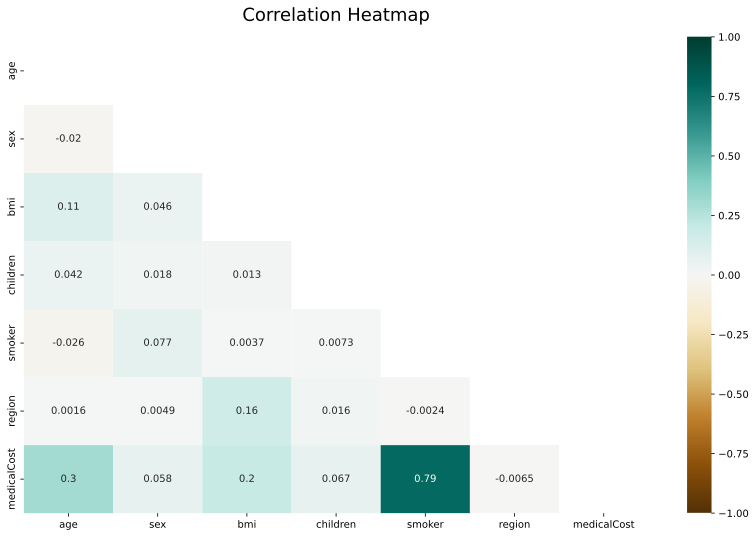

In [963]:
plt.figure(figsize=(14, 8.6))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(df.corr(), dtype=bool))
heatmap = sns.heatmap(df.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

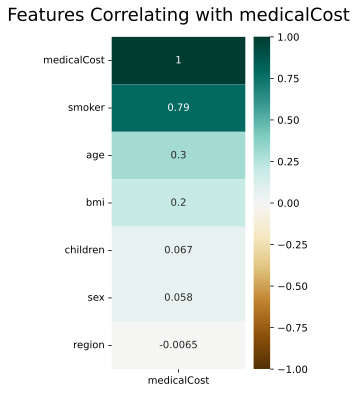

In [964]:
P


In [965]:
correlations = {i:df['medicalCost'].corr(df[i]) for i in df.columns}
for item in correlations:
    print(f'The correlation between medicalCost and {item} is : {correlations[item]}')

The correlation between medicalCost and age is : 0.2983082125097864
The correlation between medicalCost and sex is : 0.0580444957903129
The correlation between medicalCost and bmi is : 0.1984008312262494
The correlation between medicalCost and children is : 0.06738935083963243
The correlation between medicalCost and smoker is : 0.7872343672800324
The correlation between medicalCost and region is : -0.006546562848965918
The correlation between medicalCost and medicalCost is : 1.0


## Ploting the non-categorical data


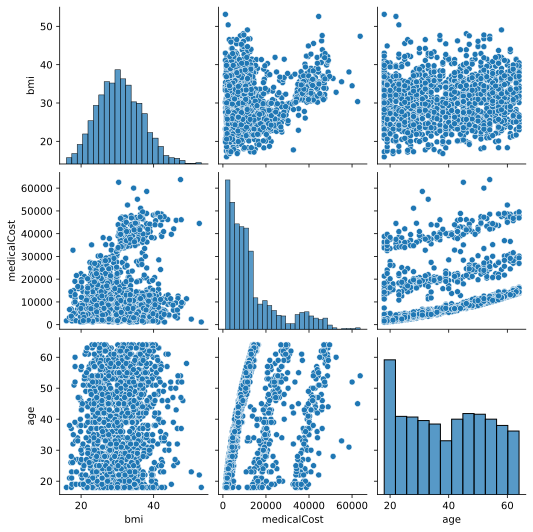

In [846]:
sns.pairplot(df[['bmi', 'medicalCost', 'age']]);

In [929]:
def outlayer_remover(df):
    """
    This funtion get the dataframe, then drop the rows with target's standard deviation
    over the 3 or -3. Finally it returns the modified dataframe withot outlayers. 
    """
    # Create a copy of original daframe
    df_without_outlayers = df.copy()

    # Calculating z-scores for sale prices
    zscores = stats.zscore(df_without_outlayers['medicalCost'])

    # Capturing the outlayers
    outlayers = zscores[abs(zscores) > 3]

    # Removving outlayers from the daaset
    for index in outlayers.index:
        df_without_outlayers.drop(index, inplace=True)

    # Print the number of outlayers
    print(f'{df.shape[0] - df_without_outlayers.shape[0]} Houses are detected as outlayers')

    return df_without_outlayers

In [930]:
df = outlayer_remover(df)

7 Houses are detected as outlayers


In [646]:
from sklearn.model_selection import train_test_split

In [660]:
xtrain, xtest, ytrain, ytest = train_test_split(transformed_df.drop(['medicalCost'], axis=1), transformed_df['medicalCost'], test_size=0.2, random_state=42)

In [648]:
from sklearn.linear_model import LinearRegression


In [649]:
model = LinearRegression()

In [650]:
model.fit(xtrain, ytrain)

LinearRegression()

In [651]:
model.score(xtrain, ytrain)

0.7592757914047423

In [652]:
model.score(xtest, ytest)

0.8339808509073594

In [556]:
df[df.index == 1069]

,age,sex,bmi,children,smoker,region,medicalCost,ac,age_bmi,marital,powerchild,bmigroup,agegroup
1069,37,1,37.07,1,1,2,39871.7043,37,1.001892,1.0,37,2,3


In [ ]:
xtrain.shape

In [ ]:
df[['age','sex','bmi','children','smoker','region','medicalCost']]

In [796]:
def box_cox_transformer(df):
    transformed_df = df.copy()
#     skewed_features = df.columns
    skewed_features = ['bmi', 'medicalCost', 'age']
    initial_skew_list = []
    transformed_skew_list = []

    # Creating a dictionary to store lambdas in it
    lambda_dic = {}

    # Adding epsilon to data
    epsilon = 10e-10
    transformed_df = transformed_df + epsilon

    # Implementing box-cox
    for column in skewed_features:
        transformed_df[column], lambda_dic[column] = boxcox(transformed_df[column])
        initial_skew_list.append(df[column].skew())
        transformed_skew_list.append(transformed_df[column].skew())

    # Creating a dataframe to compare skewness before and after transformation
    skew_dataframe = pd.DataFrame(index=skewed_features, data={'Original Data Skew':initial_skew_list, 'Transformed Data Skew':transformed_skew_list} )
    
    return transformed_df, skew_dataframe, lambda_dic

In [797]:
transformed_df, skew_dataframe, lambda_dic = box_cox_transformer(df)

In [577]:
sns.pairplot(transformed_df)

In [578]:
transformed_df

,age,sex,bmi,children,smoker,region,medicalCost,ac,age_bmi,marital,powerchild,bmigroup,agegroup
0,8.479163,-2.013033e+01,7.882305,-1.411102e+01,1.000000e-09,1.207156e+00,12.120634,-14.880955,0.358109,-1.385327e+01,-14.880955,1.000000e-09,7.376552e-01
1,8.144205,1.000000e-09,8.806054,1.000000e-09,-4.663288e+02,7.353557e-01,8.804027,3.036909,0.561273,1.000000e-09,3.036909,7.796204e-01,7.376552e-01
2,11.243832,1.000000e-09,8.690111,1.122991e+00,-4.663288e+02,7.353557e-01,10.141549,4.781356,0.159404,1.000000e-09,4.781356,7.796204e-01,7.376552e-01
3,12.633104,1.000000e-09,6.972517,-1.411102e+01,-4.663288e+02,1.000000e-09,12.526076,-14.880955,-0.401049,-1.385327e+01,-14.880955,-3.001549e+00,1.213213e+00
4,12.361939,1.000000e-09,8.043361,-1.411102e+01,-4.663288e+02,1.000000e-09,9.939887,-14.880955,-0.104560,-1.385327e+01,-14.880955,1.000000e-09,1.213213e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1332,16.854583,1.000000e-09,8.377256,1.122991e+00,-4.663288e+02,1.000000e-09,11.416735,5.461951,-0.524116,1.000000e-09,5.461951,7.796204e-01,-5.484622e+00
1333,8.144205,-2.013033e+01,8.525002,-1.411102e+01,-4.663288e+02,-5.741500e+00,9.145579,-14.880955,0.516175,-1.385327e+01,-14.880955,7.796204e-01,7.376552e-01
1334,8.144205,-2.013033e+01,9.256115,-1.411102e+01,-4.663288e+02,7.353557e-01,8.725191,-14.880955,0.629309,-1.385327e+01,-14.880955,7.796204e-01,7.376552e-01
1335,9.129882,-2.013033e+01,7.526579,-1.411102e+01,-4.663288e+02,1.207156e+00,9.014352,-14.880955,0.198201,-1.385327e+01,-14.880955,1.000000e-09,7.376552e-01


In [654]:
df_smoker = df[df.smoker == 1]
df_nonsmoker = df[df.smoker == 0]

In [734]:
xtrain, xtest, ytrain, ytest = train_test_split(transformed_df.drop(['medicalCost'], axis=1), transformed_df['medicalCost'], test_size=0.2, random_state=42)

In [735]:
model = LinearRegression()
model.fit(xtrain, ytrain)
model.score(xtest, ytest)

0.7087935023398412

In [736]:
randomf = RandomForestRegressor()

In [737]:
randomf.fit(xtrain, ytrain)

RandomForestRegressor()

In [738]:
randomf.score(xtest, ytest)

0.7418012958088862

In [739]:
randomf.predict(xtest)

array([ 9.27861832, 12.59932791, 12.2240548 , 11.16137971, 12.79863022,
       13.84764139, 14.28328746,  9.60342012, 12.76735757,  9.93960783,
       13.81884462, 12.02526607, 10.85486446,  9.60215402,  9.21141773,
       10.91876231, 12.03712248, 11.30336304, 12.38505302, 12.85204832,
        9.5949557 , 11.88372999,  8.64394431, 13.82320402, 10.96634778,
       11.03089379, 11.04403407, 10.63082188, 12.27753384, 12.85727524,
       14.09832478, 10.92106567, 11.39712621, 11.59353376, 10.25226254,
       10.75472009, 13.51873587, 14.09215029, 12.2134521 , 14.15205508,
       12.56874554,  9.16911955, 11.03964322, 13.27750441, 12.10177457,
       10.84230116, 11.98504749,  9.66727834, 13.84230162, 10.93151878,
        9.6781873 , 12.28825815, 12.23931194, 12.62185677, 13.11930558,
        9.75376645, 12.79433594,  9.54273898, 11.97938141, 11.11645594,
       12.59406674, 10.98031345, 11.08764135, 10.81227549, 11.15530985,
       11.55846482, 12.51367051, 11.7570531 ,  9.37920047,  9.50

In [684]:
x_incl_const = sm.add_constant(xtrain) 
            
# building our model for original dataset
model = sm.OLS(ytrain, x_incl_const)

# fitting the regression on our model and store the result in results variable
results = model.fit() 
results.rsquared(xtest, ytest)

TypeError: 'numpy.float64' object is not callable

In [685]:
results.predict(xtest)

ValueError: shapes (268,12) and (13,) not aligned: 12 (dim 1) != 13 (dim 0)

In [688]:
from sklearn.preprocessing import StandardScaler
  


# define standard scaler
scaler = StandardScaler()
  
# transform data
standard_df = scaler.fit_transform(transformed_df)

In [689]:
standard_df

array([[-1.52809907, -1.00977099, -0.40951125, ..., -0.84739979,
        -0.54599487,  0.42068079],
       [-1.62074341,  0.99032355,  0.54869688, ..., -0.49819562,
         0.60723601,  0.42068079],
       [-0.76343287,  0.99032355,  0.42842887, ...,  0.78221966,
         0.60723601,  0.42068079],
       ...,
       [-1.62074341, -1.00977099,  1.01554649, ..., -0.84739979,
         0.60723601,  0.42068079],
       [-1.34811991, -1.00977099, -0.77850737, ..., -0.84739979,
        -0.54599487,  0.42068079],
       [ 1.46401555, -1.00977099, -0.21041336, ..., -0.84739979,
        -0.54599487, -0.49985966]])

In [691]:
xtrain, xtest, ytrain, ytest = train_test_split(standard_df.drop(['medicalCost'], axis=1), standard_df['medicalCost'], test_size=0.2, random_state=42)

AttributeError: 'numpy.ndarray' object has no attribute 'drop'

In [847]:
def feature_target_splitter(df):
        """
        This function takes the original dataframe and returns features and targets
        """ 
        # Creating Features and Targets
        target = df['medicalCost']
        features = df.drop('medicalCost', axis=1)
        
        return features, target

In [931]:
class machine_learning():
    
    
    def __init__(self, df, transformed_df):
        
        self.features, self.target = feature_target_splitter(df)
        
        # t_features, t_target : features and target for transformed dataframe
        self.t_features, self.t_target = feature_target_splitter(transformed_df)
    
    
    
    def multi_regr_with_scikit(self, num_iteration=50):
        
        """
        This function uses Scikit-Learn Multivariate Liniear Regression model to perform
        linear regression in our database.
        It takes two dataframe as the input.
        It prints the accuracy for both dataframes.
        Also it returns a dataframe which contains three column.
        
        
        coef : the coeficient for different features for transformed model with random_stae=50.
        average : the mean value for each feature on the dataframe
        Effect on price : Effect on price = coef * average. This index is a measurment to evaluate the effect of each feature on price.
        the bigger absolute value of this number, the more effect this feature has on price.
    
        
        As our model accuracy depends on how we splited data to trian and test,
        this function perform linear regression for 50 different train and test datasets.
        Then it return the average of all models to prevent the biased result regarding train and test random_seed.
        
        
        num_iteration : The number of times we perform linear regression with different train and tests.
        df : Original dataframe without data transformation
        transformed_df : The dataframe with transformed values
        Then do linear regression separately for both these datasets.
        """
        
        # defining two variables for storing the accuracy of models
        normal_model = 0
        transformed_model = 0
        
        # Create a for loop for run on model for num_iteration dufferent train, test datasets
        for i in range(int(num_iteration)):
            
            # splitting the original and transformed datasets to train and test datasets
            x_train, x_test, y_train, y_test = train_test_split(self.features, self.target, random_state=i)
            xt_train, xt_test, yt_train, yt_test = train_test_split(self.t_features,
                                                                                     self.t_target, random_state=i)
            # building our model for original dataset
            model = LinearRegression()
            
            # fitting the regression on our model
            model.fit(x_train, y_train)
            
            # adding the model accuracy to score container
            normal_model = normal_model + model.score(x_test, y_test)

            # Same steps as above for transformed dataset
            model = LinearRegression()
            model.fit(xt_train, yt_train)
            transformed_model = transformed_model +  model.score(xt_test, yt_test)

        # deviding the scores by number of iterations to get the average r-squared
        normal_score = normal_model / num_iteration
        transformed_score = transformed_model / num_iteration
        
        # creating a dataframe to store the coeficients and average values of features
        data = pd.DataFrame({'coef':np.around(model.coef_, 4),
                             'average':[self.features[i].mean() for i in self.features.columns]}, index=self.features.columns)
        
        # evaluating features effect on price
        data['Effect on price'] = [data.iloc[i ,0] * data.iloc[i, 1] for i in range(len(data.index))]
        
        # printing the average accuracy for original and transformed datasets
        print('Normal model score is: ', normal_score)
        print('Transformed model score is: ', transformed_score, '\n\n')
        
        return data
    
    
    
    
    
    
    def multi_regr_with_lstat(self, num_iteration=50):
        
        """
        This function uses StatsModel Ordinary Least Squares Liniear Regression model to perform
        multivariate linear regression on our database.
        It takes two dataframe as the input.
        It prints the accuracy for both dataframes.
        Also it returns a dataframe which contains three column.
        
        
        coef : the coeficient for different features for transformed model with random_stae=50.
        average : the mean value for each feature in the dataframe
        Effect on price : Effect on price = coef * average. This index is a measurment to evaluate the effect of each feature on price.
        the bigger absolute value of this number, the more effect this feature has on price.
    
        
        As our model accuracy depends on how we splited data to trian and test,
        this function perform linear regression for 50 different train and test datasets.
        Then it return the average of all models to prevent the biased result regarding train and test random_seed.
        
        
        num_iteration : The number of times we perform linear regression with different train and tests.
        df : Original dataframe without data transformation
        transformed_df : The dataframe with transformed values
        Then do linear regression separately for both these datasets.
        
        Outputs:
        
        """

        # defining two variables for storing the accuracy of models
        normal_model = 0
        transformed_model = 0

        # Create a for loop for run on model for num_iteration dufferent train, test datasets
        for i in range(int(num_iteration)):

            # splitting the original and transformed datasets to train and test datasets
            x_train, x_test, y_train, y_test = train_test_split(self.features, self.target, random_state=i)
            xt_train, xt_test, yt_train, yt_test = train_test_split(self.t_features,
                                                                                     self.t_target, random_state=i)
            
            #create a dataframe with a column name constant
            x_incl_const = sm.add_constant(x_train) 
            
            # building our model for original dataset
            model = sm.OLS(y_train, x_incl_const)
            
            # fitting the regression on our model and store the result in results variable
            results = model.fit() 
            normal_model += results.rsquared
            
            
            prices = pd.DataFrame({'coef':results.params, 'p-values':round(results.pvalues,3)})

            
            # Same steps as above for transformed dataset
            x_incl_const = sm.add_constant(xt_train) 
            model = sm.OLS(yt_train, x_incl_const) 
            results = model.fit()
            transformed_model += results.rsquared
            
            
            # creating a dataframe to store the coeficients and p-values of features
            short_summary = pd.DataFrame({'coef':results.params, 'p-values':round(results.pvalues,3)})
            
            # VIF Factor column to store variance inflation factor for each column
            vif = [round(variance_inflation_factor(x_train.values, i),3)  for i in range(x_train.shape[1])]
            vif.insert(0, 0)
            short_summary["VIF Factor"] = vif
            long_summary = results.summary()
    
        # Printing BIC ,AIC, and r-squared for transformed model with random_state = 50
        print('BIC is: ' , results.bic)
        print('AIC is: ' , results.aic)
        print('r-squared for original dataframe is: ',normal_model/num_iteration)
        print('r-squared for modified dataframe is: ',transformed_model/num_iteration)


        return short_summary, long_summary
    
    
    
    
    
    
    def multi_regr_with_randomforest(self, num_iteration=50):

        # defining two variables for storing the accuracy of models
        normal_model = 0
        transformed_model = 0
        log_evs = 0
    #     prediction_df = pd.DataFrame(index=range(len(test_features)), columns=range(int(num_iteration)))


        # Create a for loop for run on model for num_iteration dufferent train, test datasets
        for i in range(int(num_iteration)):
            
            # splitting the original and transformed datasets to train and test datasets
            x_train, x_test, y_train, y_test = train_test_split(self.features, self.target, random_state=i)
            xt_train, xt_test, yt_train, yt_test = train_test_split(self.t_features,
                                                                                     self.t_target, random_state=i)

            # building our model for original dataset
            model = RandomForestRegressor(n_estimators = 10, random_state = 0)
            
            # fitting the regression on our model 
            model.fit(x_train, y_train) 
            
            # Storing the prediction for test dataset in y_pred 
            y_pred = model.predict(x_test)
            
            # adding the r2-squared (accuracy) to the container
            normal_model = normal_model + r2_score(y_test, y_pred)


            # Same steps as above for transformed dataset
            model = RandomForestRegressor(n_estimators = 10, random_state = 0)
            model.fit(xt_train, yt_train)
            yt_pred = model.predict(xt_test)
            transformed_model = transformed_model + r2_score(yt_test, yt_pred)

        # deviding the scores by number of iterations to get the average r-squared
        normal_score = normal_model / num_iteration
        transformed_score = transformed_model / num_iteration
        
        # printing the average accuracy for original and transformed datasets
        print('Normal model score is: ', normal_score)
        print('Transformed model score is: ', transformed_score)
   



In [751]:
df

,age,sex,bmi,children,smoker,region,medicalCost,ac,age_bmi,marital,powerchild,bmigroup,agegroup
0,19,0,27.900,0,1,3,16884.92400,0,1.468421,0.0,0,1,2
1,18,1,33.770,1,0,2,1725.55230,18,1.876111,1.0,18,2,2
2,28,1,33.000,3,0,2,4449.46200,84,1.178571,1.0,84,2,2
3,33,1,22.705,0,0,1,21984.47061,0,0.688030,0.0,0,0,3
4,32,1,28.880,0,0,1,3866.85520,0,0.902500,0.0,0,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1332,50,1,30.970,3,0,1,10600.54830,150,0.619400,1.0,150,2,0
1333,18,0,31.920,0,0,0,2205.98080,0,1.773333,0.0,0,2,2
1334,18,0,36.850,0,0,2,1629.83350,0,2.047222,0.0,0,2,2
1335,21,0,25.800,0,0,3,2007.94500,0,1.228571,0.0,0,1,2


In [852]:
ml = machine_learning(df_raw, df_raw)

In [853]:
ml.multi_regr_with_scikit()

Normal model score is:  0.7450727651870794
Transformed model score is:  0.7450727651870794 




,coef,average,Effect on price
age,253.7277,39.222139,9951.743147
sex,-0.0763,0.504862,-0.038521
bmi,316.6715,30.663452,9710.241263
children,565.2923,1.095737,619.411533
smoker,24078.3447,0.204936,4934.529879
region,-508.2548,1.516081,-770.555333


In [854]:
ml.multi_regr_with_randomforest()

Normal model score is:  0.8248945627839306
Transformed model score is:  0.8248945627839306


In [855]:
ml.multi_regr_with_lstat()

BIC is:  20345.802503154613
AIC is:  20311.4342301831
r-squared for original dataframe is:  0.7510251353470523
r-squared for modified dataframe is:  0.7510251353470523


(                  coef  p-values  VIF Factor
 const    -11115.762898     0.000       0.000
 age         253.727745     0.000       7.237
 sex          -0.076316     1.000       2.041
 bmi         316.671520     0.000      10.140
 children    565.292316     0.000       1.806
 smoker    24078.344749     0.000       1.243
 region     -508.254821     0.004       2.957,
 <class 'statsmodels.iolib.summary.Summary'>
 """
                             OLS Regression Results                            
 Dep. Variable:            medicalCost   R-squared:                       0.748
 Model:                            OLS   Adj. R-squared:                  0.746
 Method:                 Least Squares   F-statistic:                     492.1
 Date:                Mon, 29 May 2023   Prob (F-statistic):          1.23e-293
 Time:                        19:19:28   Log-Likelihood:                -10149.
 No. Observations:                1002   AIC:                         2.031e+04
 Df Residuals:       

In [966]:
ml = machine_learning(df, df)

In [967]:
ml.multi_regr_with_scikit()

Normal model score is:  0.7450727651870794
Transformed model score is:  0.7450727651870794 




,coef,average,Effect on price
age,253.7277,39.222139,9951.743147
sex,-0.0763,0.504862,-0.038521
bmi,316.6715,30.663452,9710.241263
children,565.2923,1.095737,619.411533
smoker,24078.3447,0.204936,4934.529879
region,-508.2548,1.516081,-770.555333


In [968]:
ml.multi_regr_with_randomforest()

Normal model score is:  0.8248945627839306
Transformed model score is:  0.8248945627839306


In [ ]:
ml.multi_regr_with_randomforest()